### Velocity demo
Current approach shares full optimizer state between rounds. Optimizer states are aggregated when received on server end and then shared out such that all clients begin the next round with the aggregated optimizer state.
Limitations: 
- We are not measuring communication from this, but if desired, it should be pretty easy to add
- Currently, we share the entire optimizer state, but when training only a single layer, we would only need to share the state related to that layer. To only share updated layer, modify _aggregate_optimizer_states.

In [21]:
from collections import OrderedDict
from typing import Dict, List, Optional, Tuple, Union, Callable


import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import copy
import sys
import base64
import pickle
import copy
import torch.nn.functional as F
import torchvision.transforms as transforms
from datasets.utils.logging import disable_progress_bar
from torch.utils.data import DataLoader
from flwr.server.strategy import Strategy
import flwr
from flwr.client import Client, ClientApp, NumPyClient
from flwr.common import Metrics, Context, Status, GetParametersRes, Parameters, GetParametersIns, MetricsAggregationFn,NDArrays,Scalar
from flwr.server import ServerApp, ServerConfig, ServerAppComponents 
from flwr.server.strategy import FedAvg, FedProx
from flwr.simulation import run_simulation
from flwr_datasets import FederatedDataset
from flwr.common import (
    EvaluateIns,
    EvaluateRes,
    FitIns,
    FitRes,
    Parameters,
    Scalar,
    ndarrays_to_parameters,
    parameters_to_ndarrays,
)
from flwr.server.client_manager import ClientManager
from flwr.server.client_proxy import ClientProxy
from flwr.server.strategy.aggregate import aggregate, weighted_loss_avg

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Training on {DEVICE}")
print(f"Flower {flwr.__version__} / PyTorch {torch.__version__}")
disable_progress_bar()

Training on cpu
Flower 1.15.1 / PyTorch 2.6.0


In [22]:

BATCH_SIZE = 32

def load_datasets(partition_id, num_partitions: int):
    fds = FederatedDataset(dataset="cifar10", partitioners={"train": num_partitions})
    partition = fds.load_partition(partition_id)
    # Divide data on each node: 80% train, 20% test
    partition_train_test = partition.train_test_split(test_size=0.2, seed=42)
    pytorch_transforms = transforms.Compose(
        [transforms.ToTensor(), transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))]
    )

    def apply_transforms(batch):
        
        batch["img"] = [pytorch_transforms(img) for img in batch["img"]]
        return batch

    partition_train_test = partition_train_test.with_transform(apply_transforms)
    trainloader = DataLoader(partition_train_test["train"], batch_size=32, shuffle=True)
    valloader = DataLoader(partition_train_test["test"], batch_size=32)
    testset = fds.load_split("test").with_transform(apply_transforms)
    testloader = DataLoader(testset, batch_size=32)
    return trainloader, valloader, testloader

In [23]:
class Net(nn.Module):
    def __init__(self) -> None:
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(3, 6, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(16 * 5 * 5, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 16 * 5 * 5)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

def get_parameters(net) -> List[np.ndarray]:
    return [val.cpu().numpy() for _, val in net.state_dict().items()]


def set_parameters(net, parameters: List[np.ndarray]):
    params_dict = zip(net.state_dict().keys(), parameters)
    state_dict = OrderedDict({k: torch.Tensor(v) for k, v in params_dict})
    net.load_state_dict(state_dict, strict=True)


def train(net, trainloader, epochs: int, optimizer=None):
    """Train the network on the training set."""
    print(f"training network...")
    criterion = torch.nn.CrossEntropyLoss()
    if optimizer is None:
        optimizer = torch.optim.Adam(net.parameters())
    net.train()
    for epoch in range(epochs):
        correct, total, epoch_loss = 0, 0, 0.0
        for batch in trainloader:
            images, labels = batch["img"], batch["label"]
            images, labels = images.to(DEVICE), labels.to(DEVICE)
            optimizer.zero_grad()
            outputs = net(images)
            loss = criterion(net(images), labels)
            loss.backward()
            optimizer.step()
            # Metrics
            epoch_loss += loss
            total += labels.size(0)
            correct += (torch.max(outputs.data, 1)[1] == labels).sum().item()
        epoch_loss /= len(trainloader.dataset)
        epoch_acc = correct / total
        print(f"Epoch {epoch+1}: train loss {epoch_loss}, accuracy {epoch_acc}")


def test(net, testloader):
    """Evaluate the network on the entire test set."""
    criterion = torch.nn.CrossEntropyLoss()
    correct, total, loss = 0, 0, 0.0
    net.eval()
    with torch.no_grad():
        for batch in testloader:
            images, labels = batch["img"], batch["label"]
            images, labels = images.to(DEVICE), labels.to(DEVICE)
            outputs = net(images)
            loss += criterion(outputs, labels).item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    loss /= len(testloader.dataset)
    accuracy = correct / total
    return loss, accuracy

def freeze_layers(model: torch.nn.Module, trainable_layers: int) -> None:
        """Freeze specified layers of the model."""
        for idx, (name, param) in enumerate(model.named_parameters()):
            if idx == trainable_layers or trainable_layers == -1:
                param.requires_grad = True
            else:
                param.requires_grad = False

def get_parameters_size(params: Parameters) -> int:
    size = sys.getsizeof(params)  # Base size of the dataclass instance
    size += sys.getsizeof(params.tensor_type)  # Size of the string
    size += sys.getsizeof(params.tensors)  # Size of the list container
    size += sum(sys.getsizeof(tensor) for tensor in params.tensors)  # Size of each bytes object
    return size


In [24]:

NETWORK_LEN = len(Net().state_dict().keys())
EPOCHS = 5
NUM_PARTITIONS = 3
NUM_OF_CYCLES  = 1
NUM_OF_FULL_UPDATES_BETWEEN_CYCLES = 5
NUM_OF_ROUNDS = (NUM_OF_CYCLES * NUM_OF_FULL_UPDATES_BETWEEN_CYCLES) + (NUM_OF_CYCLES * NETWORK_LEN *2)
print(f"Number of rounds: {NUM_OF_ROUNDS}")
backend_config = {"client_resources": {"num_cpus": 1, "num_gpus": 0.0}}


Number of rounds: 25


In [25]:
from flwr.common import NDArrays, Scalar

def get_evaluate_fn(
    testloader: DataLoader,
    net: torch.nn.Module,
) -> Callable[[int, NDArrays, Dict[str, Scalar]], Optional[Tuple[float, Dict[str, Scalar]]]]:
    """Return an evaluation function for server-side evaluation."""

    def evaluate(
        server_round: int, parameters: NDArrays, config: Dict[str, Scalar]
    ) -> Optional[Tuple[float, Dict[str, Scalar]]]:
        """Use the entire test set for evaluation."""
        
        # Copy model parameters to avoid modifying the original
        net_copy = copy.deepcopy(net)
        
        # Update model with the latest parameters
        params_dict = zip(net_copy.state_dict().keys(), parameters)
        state_dict = OrderedDict({k: torch.tensor(v) for k, v in params_dict})
        net_copy.load_state_dict(state_dict, strict=True)
        
        net_copy.to(DEVICE)
        net_copy.eval()

        # Test the model
        loss, accuracy = test(net_copy, testloader)
        
        # Return loss and metrics
        return loss, {"accuracy": accuracy}

    return evaluate

# FedAvg with velocity from global model

In [ ]:
from typing import Union

from flwr.common import (
    EvaluateIns,
    EvaluateRes,
    FitIns,
    FitRes,
    Parameters,
    Scalar,
    ndarrays_to_parameters,
    parameters_to_ndarrays,
)
from flwr.server.client_manager import ClientManager
from flwr.server.client_proxy import ClientProxy
from flwr.server.strategy.aggregate import aggregate, weighted_loss_avg

fed_part_avg_result = {}
fed_part_avg_model_results = {}

class FedPartAvgWithVelocity(Strategy):
    def __init__(
        self,
        fraction_fit: float = 1.0,
        fraction_evaluate: float = 1.0,
        min_fit_clients: int = 2,
        min_evaluate_clients: int = 2,
        min_available_clients: int = 2,
        evaluate_fn: Optional[
            Callable[
                [int, NDArrays, dict[str, Scalar]],
                Optional[tuple[float, dict[str, Scalar]]],
            ]
        ] = None,
        on_fit_config_fn: Optional[Callable[[int], dict[str, Scalar]]] = None,
        on_evaluate_config_fn: Optional[Callable[[int], dict[str, Scalar]]] = None,
        accept_failures: bool = True,
        initial_parameters: Optional[Parameters] = None,
        fit_metrics_aggregation_fn: Optional[MetricsAggregationFn] = None,
        evaluate_metrics_aggregation_fn: Optional[MetricsAggregationFn] = None,
        inplace: bool = True,
        layer_update_strategy: str = "sequential",
        
    ) -> None:
        super().__init__()
        self.fraction_fit = fraction_fit
        self.fraction_evaluate = fraction_evaluate
        self.min_fit_clients = min_fit_clients
        self.min_evaluate_clients = min_evaluate_clients
        self.min_available_clients = min_available_clients
        self.evaluate_fn = evaluate_fn
        self.on_fit_config_fn = on_fit_config_fn
        self.on_evaluate_config_fn = on_evaluate_config_fn
        self.accept_failures = accept_failures
        self.initial_parameters = initial_parameters
        self.fit_metrics_aggregation_fn = fit_metrics_aggregation_fn
        self.evaluate_metrics_aggregation_fn = evaluate_metrics_aggregation_fn
        self.inplace = inplace

        self.layer_update_strategy = layer_update_strategy  # 'sequential' or 'cyclic'
        self.current_layer = 0  # Track which layer to update
        self.number_of_layers = None
        self.layer_training_sequence = []
        self.training_sequence_index = 0
        self.latest_parameters = initial_parameters
        self.global_optim_state = None


    def __repr__(self) -> str:
        return "FedPartAvgWithVelocity"
    

    def num_fit_clients(self, num_available_clients: int) -> Tuple[int, int]:
        """Return sample size and required number of clients."""
        num_clients = int(num_available_clients * self.fraction_fit)
        return max(num_clients, self.min_fit_clients), self.min_available_clients

    def num_evaluation_clients(self, num_available_clients: int) -> Tuple[int, int]:
        """Use a fraction of available clients for evaluation."""
        num_clients = int(num_available_clients * self.fraction_evaluate)
        return max(num_clients, self.min_evaluate_clients), self.min_available_clients
    
    def generate_layer_training_sequence(self) -> List[int]:
        """Generate a sequence of layers to train."""
        layer_training_sequence = []
        for _ in range(NUM_OF_CYCLES):
            for _ in range(NUM_OF_FULL_UPDATES_BETWEEN_CYCLES):
                    layer_training_sequence.append(-1)
            for layer in range(NETWORK_LEN):
                    layer_training_sequence.append(layer)
                    layer_training_sequence.append(layer)

        return layer_training_sequence

    def initialize_parameters(
        self, client_manager: ClientManager
    ) -> Optional[Parameters]:
        """Initialize global model parameters."""
        net = Net()
        ndarrays = get_parameters(net)
        self.layer_training_sequence = self.generate_layer_training_sequence()
        self.number_of_layers = len(ndarrays)

        return ndarrays_to_parameters(ndarrays)
    


    def evaluate(
        self, server_round: int, parameters: Parameters
    ) -> Optional[tuple[float, dict[str, Scalar]]]:
        """Evaluate model parameters using an evaluation function."""
        if self.evaluate_fn is None:
            # No evaluation function provided
            return None
        parameters_ndarrays = parameters_to_ndarrays(parameters)
        eval_res = self.evaluate_fn(server_round, parameters_ndarrays, {})
        if eval_res is None:
            return None
        
        if server_round in fed_part_avg_model_results:  
            expand_fed_part_avg_model_results= {**fed_part_avg_model_results[server_round], "global_loss": eval_res[0], "global_metrics": eval_res[1]}
        else:
            expand_fed_part_avg_model_results= {"global_loss": eval_res[0], "global_metrics": eval_res[1]}
        
        fed_part_avg_model_results[server_round] = expand_fed_part_avg_model_results
        
        loss, metrics = eval_res
        return loss, metrics

    def configure_fit(
        self, server_round: int, parameters: Parameters, client_manager: ClientManager
    ) -> List[Tuple[ClientProxy, FitIns]]:
        """Configure the next round of training."""
        
        config = {"trainable_layers": self.layer_training_sequence[self.training_sequence_index]}

        if self.global_optim_state is not None:
            config["optimizer_state"] = self.global_optim_state
        
        sample_size, min_num_clients = self.num_fit_clients(
            client_manager.num_available()
        )
        clients = client_manager.sample(
            num_clients=sample_size, min_num_clients=min_num_clients
        )
        
        print(f"Training on layer {self.layer_training_sequence}")
        fit_configurations = []
        for idx, client in enumerate(clients):
            fit_configurations.append((client, FitIns(parameters, config)))

        self.training_sequence_index = self.training_sequence_index + 1
        
        return fit_configurations
    

    def configure_evaluate(
        self, server_round: int, parameters: Parameters, client_manager: ClientManager
    ) -> List[Tuple[ClientProxy, EvaluateIns]]:
        """Configure the next round of evaluation."""
        if self.fraction_evaluate == 0.0:
            return []
        config = {}
        evaluate_ins = EvaluateIns(parameters, config)

        # Sample clients
        sample_size, min_num_clients = self.num_evaluation_clients(
            client_manager.num_available()
        )
        clients = client_manager.sample(
            num_clients=sample_size, min_num_clients=min_num_clients
        )

        # Return client/config pairs
        return [(client, evaluate_ins) for client in clients]

    def aggregate_fit(
        self,
        server_round: int,
        results: List[Tuple[ClientProxy, FitRes]],
        failures: List[Union[Tuple[ClientProxy, FitRes], BaseException]],
    ) -> Tuple[Optional[Parameters], Dict[str, Scalar]]:
        global global_all_optimizer_states
        """Aggregate fit results using weighted average."""
        
        total_size = 0
        # print(f"Getting results: {results}")
        for client, fit_res in results:
            total_size += get_parameters_size(fit_res.parameters)
        #     print(f"fit res is: {fit_res}")
        #     print(f"fit res metrics: {fit_res.metrics}")
        print(f"total size: {total_size}")
        
        if fed_part_avg_result.get(server_round):
            fed_part_avg_result[server_round]["total_size"] = total_size
        else:
            fed_part_avg_result[server_round] = {"total_size": total_size}
        


        weights_results = [
            (parameters_to_ndarrays(fit_res.parameters), fit_res.num_examples)
            for _, fit_res in results
        ]

        aggregated_weights = aggregate(weights_results)
        # parameters_aggregated = ndarrays_to_parameters(aggregate(weights_results))

        if self.layer_training_sequence[self.training_sequence_index -1] == -1:
            self.latest_parameters = ndarrays_to_parameters(aggregated_weights)
        else:
            current_model = parameters_to_ndarrays(self.latest_parameters)
            current_model[self.layer_training_sequence[self.training_sequence_index -1]] = aggregated_weights[0]
            self.latest_parameters = ndarrays_to_parameters(current_model)

        metrics = {}
        # include optimizer state in metrics

        optimizer_states_serialized = [res.metrics.get("optimizer_state", None) for _, res in results]
        optimizer_states = [pickle.loads(base64.b64decode(state)) for state in optimizer_states_serialized if state is not None]

        aggregated_optimizer_state = self._aggregate_optimizer_states(optimizer_states)
        aggregated_optimizer_state_serialized = base64.b64encode(pickle.dumps(aggregated_optimizer_state)).decode('ascii')
        metrics["optimizer_state"] = aggregated_optimizer_state_serialized
        self.global_optim_state = aggregated_optimizer_state_serialized

        return self.latest_parameters, metrics

    def _aggregate_optimizer_states(self, optimizer_states):
        # aggregates by comuting (unweighted) mean of 1st and 2nd momentum, and taking the maximum step value. (alternatively, could be changed to reset steps to 0)
        aggregated_state_dict = copy.deepcopy(optimizer_states[0])

        for layer in range(len(optimizer_states[0]['state'])):
            fst_momentums = []
            snd_momentums = []
            steps = []
            for s in range(len(optimizer_states)):
                fst_momentums.append(optimizer_states[s]['state'][layer]['exp_avg'])
                snd_momentums.append(optimizer_states[s]['state'][layer]['exp_avg_sq'])
                steps.append(optimizer_states[s]['state'][layer]['step'])
            
            mean_fst_momentum = torch.mean(torch.stack(fst_momentums), dim=0)
            mean_snd_momentum = torch.mean(torch.stack(snd_momentums), dim=0)
            max_step = torch.max(torch.stack(steps))

            aggregated_state_dict['state'][layer]['exp_avg'][:] = mean_fst_momentum
            aggregated_state_dict['state'][layer]['exp_avg_sq'][:] = mean_snd_momentum
            aggregated_state_dict['state'][layer]['step'] = torch.tensor([max_step])
        
        return aggregated_state_dict


    def aggregate_evaluate(
        self,
        server_round: int,
        results: List[Tuple[ClientProxy, EvaluateRes]],
        failures: List[Union[Tuple[ClientProxy, EvaluateRes], BaseException]],
    ) -> Tuple[Optional[float], Dict[str, Scalar]]:
        """Aggregate evaluation losses using weighted average."""

        if not results:
            return None, {}
        
        total_loss = 0
        for _, evaluate_res in results:
            total_loss += evaluate_res.loss

        if fed_part_avg_result.get(server_round):
            fed_part_avg_result[server_round]["total_loss"] = total_loss
        else:
            fed_part_avg_result[server_round] = {"total_loss": total_loss}

        loss_aggregated = weighted_loss_avg(
            [
                (evaluate_res.num_examples, evaluate_res.loss)
                for _, evaluate_res in results
            ]
        )
        metrics_aggregated = {}
        return loss_aggregated, metrics_aggregated

    

In [ ]:
class FedAvgPartWithVelocityFlowerClient(NumPyClient):
    def __init__(self, partition_id, net, trainloader, valloader):
        self.partition_id = partition_id
        self.net = net
        self.trainloader = trainloader
        self.valloader = valloader

    def get_parameters(self, config):
        print(f"[Client {self.partition_id}] get_parameters")
        parameters = get_parameters(self.net)
        if config["trainable_layers"] == -1:
            trained_layers = parameters
        else:
            trained_layers = [parameters[config["trainable_layers"]]]
        
        return trained_layers

    def fit(self, parameters, config):
        print(f"[Client {self.partition_id}] fit, config: {config}")
        set_parameters(self.net, parameters)
        freeze_layers(self.net, config["trainable_layers"])
        self.optimizer = torch.optim.Adam(self.net.parameters())

        if "optimizer_state" in config:
            print(f"Got optimizer state in config, setting..")
            serialized_optimizer_state = config["optimizer_state"]
            optim_state = pickle.loads(base64.b64decode(serialized_optimizer_state))
            self._set_optimizer_state(optim_state)

        train(self.net, self.trainloader, epochs=EPOCHS, optimizer=self.optimizer)
        print('finished train')

        # handle optimizer state (serialize before passing)
        optim_state = self._get_optimizer_state()
        serialized_optimizer_state = base64.b64encode(pickle.dumps(optim_state)).decode('ascii')
        print(f"After training, got optim state {serialized_optimizer_state[:50]}")

        return self.get_parameters(config), len(self.trainloader), {"optimizer_state": serialized_optimizer_state}

    def evaluate(self, parameters, config):
        print(f"[Client {self.partition_id}] evaluate, config: {config}")
        set_parameters(self.net, parameters)
        loss, accuracy = test(self.net, self.valloader)
        return float(loss), len(self.valloader), {"accuracy": float(accuracy)}

    
    def _get_optimizer_state(self):
        state_dict = self.optimizer.state_dict()
        return state_dict
    
    def _set_optimizer_state(self, state_dict):
        self.optimizer.load_state_dict(state_dict)


def client_fn(context: Context) -> Client:
    net = Net().to(DEVICE)
    partition_id = context.node_config["partition-id"]
    num_partitions = context.node_config["num-partitions"]
    trainloader, valloader, _ = load_datasets(partition_id, num_partitions)
    return FedAvgPartWithVelocityFlowerClient(partition_id, net, trainloader, valloader).to_client()


# Create the ClientApp
client = ClientApp(client_fn=client_fn)

In [28]:
net = Net().to(DEVICE)

_, _, testloader = load_datasets(0, NUM_PARTITIONS)

evaluate_fn = get_evaluate_fn(testloader, net)

def server_fn(context: Context) -> ServerAppComponents:
    # Configure the server for just 3 rounds of training
    config = ServerConfig(num_rounds=NUM_OF_ROUNDS)
    return ServerAppComponents(
        config=config,
        strategy=FedPartAvgWithVelocity(
            evaluate_fn=evaluate_fn,
        ),
    )

server = ServerApp(server_fn=server_fn)

# Run simulation
run_simulation(
    server_app=server,
    client_app=client,
    num_supernodes=NUM_PARTITIONS,
    backend_config=backend_config,
)

INFO :      Starting Flower ServerApp, config: num_rounds=25, no round_timeout
INFO :      
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Starting evaluation of initial global parameters
INFO :      initial parameters (loss, other metrics): 0.07213809854984284, {'accuracy': 0.0986}
INFO :      
INFO :      [ROUND 1]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 0] fit, config: {'trainable_layers': -1}
(ClientAppActor pid=37611) training network...
(ClientAppActor pid=37611) Epoch 1: train loss 0.061887167394161224, accuracy 0.2677566939173479
(ClientAppActor pid=37609) [Client 1] fit, config: {'trainable_layers': -1} [repeated 2x across cluster]
(ClientAppActor pid=37609) training network... [repeated 2x across cluster]
(ClientAppActor pid=37611) Epoch 2: train loss 0.05392790585756302, accuracy 0.3654841371034276 [repeated 3x across cluster]
(ClientAppActor pid=37611) Epoch 3: train loss 0.05060282722115517, accuracy 0.40493512337808446 [repeated 3x across cluster]
(ClientAppActor pid=37611) Epoch 4: train loss 0.04800673574209213, accuracy 0.43793594839871 [repeated 3x across cluster]
(ClientAppActor pid=37611) finished train
(ClientAppActor pid=37611) After training, got optim state gASVyGgAAAAAAAB9lCiMBXN0Y

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 749784


INFO :      fit progress: (1, 0.060891632103919985, {'accuracy': 0.2797}, 48.0027305829999)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 2] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASVyGgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 2] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.04489057883620262, accuracy 0.4684218421842184 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37609) [Client 0] fit, config: {'optimizer_state': 'gASV8mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD+YACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAsAAAAxMzM4OTk0MTIwMHECWAMAAABjcHVxA0sBTnRxBFEugAJdcQBYCwAAADEzMzg5OTQxMjAwcQFhLgEAAAAAAAAAAFACRZSFlFKUSwBLAYWUSwGFlImMC2NvbGxlY3Rpb25zlIwLT3JkZXJlZERpY3SUk5QpUpR0lFKUjAdleHBfYXZnlGgHKGgKQvwHAACAAooKbPycRvkgaqhQGS6AAk3pAy6AAn1xAChYEAAAAHByb3RvY29sX3ZlcnNpb25xAU3pA1gNAAAAbGl0dGxlX2VuZGlhbnECiFgKAAAAdHlwZV9zaXplc3EDfXEEKFgFAAAAc2hvcnRxBUsCWAMAAABpbnRxBksEWAQAAABsb25ncQdLBHV1LoACKFgHAAAAc3RvcmFnZXEAY3RvcmNoCkZsb2F0U3RvcmFnZQpxAVgKAAAANDMzO

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 749784


INFO :      fit progress: (2, 0.04342318289875984, {'accuracy': 0.4927}, 91.05568508299984)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 2] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 2] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.04252590984106064, accuracy 0.5046504650465047 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 2] fit, config: {'optimizer_state': 'gASV9GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjczMjA5MDU2cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MzIwOTA1NnEBYS4BAAAAAAAAAABQgkWUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYzOTI5O

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 749784


INFO :      fit progress: (3, 0.039152926522493366, {'accuracy': 0.5511}, 135.06793545799974)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37608) [Client 1] evaluate, config: {}
(ClientAppActor pid=37609) finished train [repeated 2x across cluster]
(ClientAppActor pid=37609) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37609) [Client 1] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37609) Epoch 5: train loss 0.03592882305383682, accuracy 0.5865896647416186 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 1] fit, config: {'optimizer_state': 'gASV8GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD+YACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAsAAAAxMzM2NDI3NzMxMnECWAMAAABjcHVxA0sBTnRxBFEugAJdcQBYCwAAADEzMzY0Mjc3MzEycQFhLgEAAAAAAAAAAHjDRZSFlFKUSwBLAYWUSwGFlImMC2NvbGxlY3Rpb25zlIwLT3JkZXJlZERpY3SUk5QpUpR0lFKUjAdleHBfYXZnlGgHKGgKQvwHAACAAooKbPycRvkgaqhQGS6AAk3pAy6AAn1xAChYEAAAAHByb3RvY29sX3ZlcnNpb25xAU3pA1gNAAAAbGl0dGxlX2VuZGlhbnECiFgKAAAAdHlwZV9zaXplc3EDfXEEKFgFAAAAc2hvcnRxBUsCWAMAAABpbnRxBksEWAQAAABsb25ncQdLBHV1LoACKFgHAAAAc3RvcmFnZXEAY3RvcmNoCkZsb2F0U3RvcmFnZQpxAVgKAAAANjI3M

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 749784


INFO :      fit progress: (4, 0.037239233350753784, {'accuracy': 0.5863}, 180.74857249999968)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37608) [Client 2] evaluate, config: {}
(ClientAppActor pid=37611) finished train [repeated 2x across cluster]
(ClientAppActor pid=37611) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37611) [Client 1] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37611) Epoch 5: train loss 0.029860064387321472, accuracy 0.6585914647866197 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 0] fit, config: {'optimizer_state': 'gASV+GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjcyMjQxMjk2cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MjI0MTI5NnEBYS4BAAAAAAAAAABQAkaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL+BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCwAAADEzMzkwM

INFO :      aggregate_fit: received 3 results and 0 failures


(ClientAppActor pid=37611) finished train
(ClientAppActor pid=37611) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI
(ClientAppActor pid=37611) [Client 0] get_parameters
(ClientAppActor pid=37611) Epoch 5: train loss 0.02564082108438015, accuracy 0.7091427285682143 [repeated 3x across cluster]
total size: 749784


INFO :      fit progress: (5, 0.037001182144880296, {'accuracy': 0.6065}, 224.41537345799952)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37609) [Client 0] evaluate, config: {}
(ClientAppActor pid=37609) finished train [repeated 2x across cluster]
(ClientAppActor pid=37609) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37609) [Client 2] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37609) Epoch 5: train loss 0.025023212656378746, accuracy 0.7162466246624662 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 1] fit, config: {'optimizer_state': 'gASV6GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjcyMjU2MjQwcQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MjI1NjI0MHEBYS4BAAAAAAAAAADkIkaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYzMTEwN

INFO :      aggregate_fit: received 3 results and 0 failures


(ClientAppActor pid=37608) finished train
(ClientAppActor pid=37608) Epoch 5: train loss 0.028729066252708435, accuracy 0.6717917947948698 [repeated 3x across cluster]
(ClientAppActor pid=37609) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI
(ClientAppActor pid=37609) [Client 2] get_parameters
total size: 6477


INFO :      fit progress: (6, 0.036147663205862046, {'accuracy': 0.6104}, 265.12271866599986)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37608) [Client 1] evaluate, config: {}
(ClientAppActor pid=37611) finished train [repeated 2x across cluster]
(ClientAppActor pid=37611) Epoch 5: train loss 0.028943205252289772, accuracy 0.6755418885472136 [repeated 2x across cluster]
(ClientAppActor pid=37611) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37611) [Client 1] get_parameters [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37609) [Client 1] fit, config: {'optimizer_state': 'gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MTQ3ODAwNzM2cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjE0NzgwMDczNnEBYS4BAAAAAAAAAAB4Q0aUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYzMTExM

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 6477


INFO :      fit progress: (7, 0.035940640771389004, {'accuracy': 0.6093}, 306.31125116600015)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37608) [Client 1] evaluate, config: {}
(ClientAppActor pid=37611) finished train [repeated 2x across cluster]
(ClientAppActor pid=37611) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37611) [Client 0] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37611) Epoch 5: train loss 0.028528710827231407, accuracy 0.6758418960474012 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37608) [Client 2] fit, config: {'optimizer_state': 'gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjczMjcwNDQ4cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MzI3MDQ0OHEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYzMTEwN

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 1149
(ClientAppActor pid=37608) Epoch 5: train loss 0.027904432266950607, accuracy 0.6818181818181818 [repeated 3x across cluster]


INFO :      fit progress: (8, 0.0358845599591732, {'accuracy': 0.6096}, 341.43415474999983)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37608) [Client 0] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 2] get_parameters [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37609) [Client 1] fit, config: {'optimizer_state': 'gASV7GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjczMjgwMzIwcQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MzI4MDMyMHEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYyNzA4N

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 1149


INFO :      fit progress: (9, 0.035875695675611496, {'accuracy': 0.6101}, 376.91594116600027)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 2] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 2] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.027903959155082703, accuracy 0.6824932493249325 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 2] fit, config: {'optimizer_state': 'gASV6GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD+YACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAsAAAAxMzM4OTkxMzUzNnECWAMAAABjcHVxA0sBTnRxBFEugAJdcQBYCwAAADEzMzg5OTEzNTM2cQFhLgEAAAAAAAAAAAxkRpSFlFKUSwBLAYWUSwGFlImMC2NvbGxlY3Rpb25zlIwLT3JkZXJlZERpY3SUk5QpUpR0lFKUjAdleHBfYXZnlGgHKGgKQvwHAACAAooKbPycRvkgaqhQGS6AAk3pAy6AAn1xAChYEAAAAHByb3RvY29sX3ZlcnNpb25xAU3pA1gNAAAAbGl0dGxlX2VuZGlhbnECiFgKAAAAdHlwZV9zaXplc3EDfXEEKFgFAAAAc2hvcnRxBUsCWAMAAABpbnRxBksEWAQAAABsb25ncQdLBHV1LoACKFgHAAAAc3RvcmFnZXEAY3RvcmNoCkZsb2F0U3RvcmFnZQpxAVgKAAAANjI3M

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 29877


INFO :      fit progress: (10, 0.03584768681526184, {'accuracy': 0.6095}, 409.429606875)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37609) [Client 0] evaluate, config: {}
(ClientAppActor pid=37609) Epoch 5: train loss 0.027765506878495216, accuracy 0.6865671641791045 [repeated 4x across cluster]
(ClientAppActor pid=37609) finished train [repeated 2x across cluster]
(ClientAppActor pid=37609) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37609) [Client 1] get_parameters [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 0] fit, config: {'optimizer_state': 'gASV7mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MzExMDIxODA4cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjMxMTAyMTgwOHEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYyNzMxM

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 29877


INFO :      fit progress: (11, 0.035888263750076296, {'accuracy': 0.6102}, 441.4848093749997)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 2] evaluate, config: {}
(ClientAppActor pid=37608) Epoch 5: train loss 0.027845725417137146, accuracy 0.683267081677042 [repeated 4x across cluster]
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 1] get_parameters [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37609) [Client 1] fit, config: {'optimizer_state': 'gASV6GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjczMTQzNDQwcQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MzE0MzQ0MHEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADQzMzkzN

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 1269


INFO :      fit progress: (12, 0.035745780950784685, {'accuracy': 0.6106}, 471.6997608749998)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37609) [Client 2] evaluate, config: {}
(ClientAppActor pid=37608) Epoch 5: train loss 0.02788270264863968, accuracy 0.6849171229280732 [repeated 3x across cluster]
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 0] get_parameters [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37609) [Client 2] fit, config: {'optimizer_state': 'gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjcyMzMzNjgwcQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MjMzMzY4MHEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYyNzIzO

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 1269


INFO :      fit progress: (13, 0.03570786874294281, {'accuracy': 0.6109}, 499.76158595800007)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 2] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 0] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.027870379388332367, accuracy 0.6850671266781669 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 2] fit, config: {'optimizer_state': 'gASV6GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MzExMTIyNjQwcQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjMxMTEyMjY0MHEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADQzMzkzM

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 577077


INFO :      fit progress: (14, 0.03544181765913963, {'accuracy': 0.617}, 527.1508045410001)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 2] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 0] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.02285219170153141, accuracy 0.7519687992199805 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37608) [Client 0] fit, config: {'optimizer_state': 'gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA0MzM5MzkyNjU2cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANDMzOTM5MjY1NnEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYyNzMxM

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 577077


INFO :      fit progress: (15, 0.035614601743221286, {'accuracy': 0.6155}, 555.0391300829997)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37609) [Client 1] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 0] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.021487558260560036, accuracy 0.769819245481137 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 0] fit, config: {'optimizer_state': 'gASV9mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjczMjYzNTg0cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MzI2MzU4NHEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL+BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCwAAADEzMzkwM

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 2517


INFO :      fit progress: (16, 0.03551853019595146, {'accuracy': 0.6191}, 582.5461071660002)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 2] evaluate, config: {}
(ClientAppActor pid=37609) finished train [repeated 2x across cluster]
(ClientAppActor pid=37609) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37609) [Client 2] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37609) Epoch 5: train loss 0.02405546046793461, accuracy 0.7295229522952296 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37609) [Client 0] fit, config: {'optimizer_state': 'gASV9mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjcyMjI0OTEycQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MjIyNDkxMnEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL+BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCwAAADEzMzY0M

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 2517
(ClientAppActor pid=37611) Epoch 5: train loss 0.024045385420322418, accuracy 0.7291479147914791 [repeated 5x across cluster]


INFO :      fit progress: (17, 0.035458783853054045, {'accuracy': 0.618}, 610.7204268329997)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37608) [Client 1] evaluate, config: {}
(ClientAppActor pid=37611) finished train [repeated 2x across cluster]
(ClientAppActor pid=37611) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37611) [Client 2] get_parameters [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37608) [Client 2] fit, config: {'optimizer_state': 'gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjczMzgzNTM2cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MzM4MzUzNnEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYzMTA1M

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 122037


INFO :      fit progress: (18, 0.036512316101789476, {'accuracy': 0.6172}, 639.7042607080002)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 0] evaluate, config: {}
(ClientAppActor pid=37611) finished train [repeated 2x across cluster]
(ClientAppActor pid=37611) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37611) [Client 0] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37611) Epoch 5: train loss 0.023267576470971107, accuracy 0.7387684692117303 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37608) [Client 0] fit, config: {'optimizer_state': 'gASV+GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA0MzM5MjgzODcycQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANDMzOTI4Mzg3MnEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL+BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCwAAADEzMzkwM

INFO :      aggregate_fit: received 3 results and 0 failures


(ClientAppActor pid=37611) finished train
(ClientAppActor pid=37611) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI
(ClientAppActor pid=37611) [Client 2] get_parameters
(ClientAppActor pid=37611) Epoch 5: train loss 0.022612521424889565, accuracy 0.7447494749474948 [repeated 6x across cluster]
total size: 122037


INFO :      fit progress: (19, 0.03689175756573677, {'accuracy': 0.614}, 667.2837740409996)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37608) [Client 1] evaluate, config: {}
(ClientAppActor pid=37609) finished train [repeated 2x across cluster]
(ClientAppActor pid=37609) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37609) [Client 1] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37609) Epoch 5: train loss 0.022756734862923622, accuracy 0.7430435760894022 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37608) [Client 2] fit, config: {'optimizer_state': 'gASVAGkAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD+YACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAsAAAAxMzM5MDE3MDg2NHECWAMAAABjcHVxA0sBTnRxBFEugAJdcQBYCwAAADEzMzkwMTcwODY0cQFhLgEAAAAAAAAAAAxkRpSFlFKUSwBLAYWUSwGFlImMC2NvbGxlY3Rpb25zlIwLT3JkZXJlZERpY3SUk5QpUpR0lFKUjAdleHBfYXZnlGgHKGgKQv4HAACAAooKbPycRvkgaqhQGS6AAk3pAy6AAn1xAChYEAAAAHByb3RvY29sX3ZlcnNpb25xAU3pA1gNAAAAbGl0dGxlX2VuZGlhbnECiFgKAAAAdHlwZV9zaXplc3EDfXEEKFgFAAAAc2hvcnRxBUsCWAMAAABpbnRxBksEWAQAAABsb25ncQdLBHV1LoACKFgHAAAAc3RvcmFnZXEAY3RvcmNoCkZsb2F0U3RvcmFnZQpxAVgLAAAAMTMzO

INFO :      aggregate_fit: received 3 results and 0 failures


(ClientAppActor pid=37608) finished train
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI
(ClientAppActor pid=37608) [Client 2] get_parameters
(ClientAppActor pid=37608) Epoch 5: train loss 0.023329485207796097, accuracy 0.7360486048604861 [repeated 6x across cluster]
total size: 2085


INFO :      fit progress: (20, 0.03688287621736527, {'accuracy': 0.6143}, 699.2666120829999)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 0] evaluate, config: {}
(ClientAppActor pid=37611) finished train [repeated 2x across cluster]
(ClientAppActor pid=37611) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37611) [Client 0] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37611) Epoch 5: train loss 0.02362268790602684, accuracy 0.7356183904597615 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 2] fit, config: {'optimizer_state': 'gASV6GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjczMjg1NzQ0cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MzI4NTc0NHEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYzMTExN

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 2085


INFO :      fit progress: (21, 0.036858147317171096, {'accuracy': 0.615}, 730.8295344999997)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 2] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 1] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.023597337305545807, accuracy 0.7346433660841521 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37609) [Client 2] fit, config: {'optimizer_state': 'gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjczMjc5NzQ0cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MzI3OTc0NHEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYzMTA4N

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 11157


INFO :      fit progress: (22, 0.03753043034672737, {'accuracy': 0.6131}, 760.7378931249996)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 1] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 0] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.02336263842880726, accuracy 0.7397434935873397 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 2] fit, config: {'optimizer_state': 'gASV/GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MzExMDcwNTEycQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjMxMTA3MDUxMnEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL+BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCwAAADEzMzY0M

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 11157


INFO :      fit progress: (23, 0.037501776891946795, {'accuracy': 0.613}, 796.6408002500002)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37609) [Client 1] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 1] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.023263078182935715, accuracy 0.7375684392109803


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37611) [Client 0] fit, config: {'optimizer_state': 'gASV6GgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MjcyMzc5NTM2cQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjI3MjM3OTUzNnEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL8BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCgAAADYzMTEwM

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 1197


INFO :      fit progress: (24, 0.03748270599842071, {'accuracy': 0.615}, 826.094230791)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 1] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 1] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.023427529260516167, accuracy 0.7347933698342458 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 3 clients (out of 3)


Training on layer [-1, -1, -1, -1, -1, 0, 0, 1, 1, 2, 2, 3, 3, 4, 4, 5, 5, 6, 6, 7, 7, 8, 8, 9, 9]
(ClientAppActor pid=37608) [Client 0] fit, config: {'optimizer_state': 'gASV9mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlIwMdG9yY2guX3V0aWxzlIwSX3JlYnVpbGRfdGVuc29yX3YylJOUKIwNdG9yY2guc3RvcmFnZZSMEF9sb2FkX2Zyb21fYnl0ZXOUk5RD94ACigps/JxG+SBqqFAZLoACTekDLoACfXEAKFgQAAAAcHJvdG9jb2xfdmVyc2lvbnEBTekDWA0AAABsaXR0bGVfZW5kaWFucQKIWAoAAAB0eXBlX3NpemVzcQN9cQQoWAUAAABzaG9ydHEFSwJYAwAAAGludHEGSwRYBAAAAGxvbmdxB0sEdXUugAIoWAcAAABzdG9yYWdlcQBjdG9yY2gKRmxvYXRTdG9yYWdlCnEBWAoAAAA2MzEwNzM4NTEycQJYAwAAAGNwdXEDSwFOdHEEUS6AAl1xAFgKAAAANjMxMDczODUxMnEBYS4BAAAAAAAAAAAMZEaUhZRSlEsASwGFlEsBhZSJjAtjb2xsZWN0aW9uc5SMC09yZGVyZWREaWN0lJOUKVKUdJRSlIwHZXhwX2F2Z5RoByhoCkL+BwAAgAKKCmz8nEb5IGqoUBkugAJN6QMugAJ9cQAoWBAAAABwcm90b2NvbF92ZXJzaW9ucQFN6QNYDQAAAGxpdHRsZV9lbmRpYW5xAohYCgAAAHR5cGVfc2l6ZXNxA31xBChYBQAAAHNob3J0cQVLAlgDAAAAaW50cQZLBFgEAAAAbG9uZ3EHSwR1dS6AAihYBwAAAHN0b3JhZ2VxAGN0b3JjaApGbG9hdFN0b3JhZ2UKcQFYCwAAADEzMzY0M

INFO :      aggregate_fit: received 3 results and 0 failures


total size: 1197


INFO :      fit progress: (25, 0.03747900969982147, {'accuracy': 0.615}, 855.1826041659997)
INFO :      configure_evaluate: strategy sampled 3 clients (out of 3)


(ClientAppActor pid=37611) [Client 1] evaluate, config: {}
(ClientAppActor pid=37608) finished train [repeated 2x across cluster]
(ClientAppActor pid=37608) After training, got optim state gASV5mgAAAAAAAB9lCiMBXN0YXRllH2UKEsAfZQojARzdGVwlI [repeated 2x across cluster]
(ClientAppActor pid=37608) [Client 0] get_parameters [repeated 2x across cluster]
(ClientAppActor pid=37608) Epoch 5: train loss 0.023488696664571762, accuracy 0.7365934148353709 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 3 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 25 round(s) in 858.83s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.061341118452620975
INFO :      		round 2: 0.043641574154899394
INFO :      		round 3: 0.0394252437075432
INFO :      		round 4: 0.03719937910117809
INFO :      		round 5: 0.037098985832051214
INFO :      		round 6: 0.03625383552843941
INFO :      		round 7: 0.035937106846523535
INFO :      		round 8: 0.03589074024466891
INFO :      		round 9: 0.03588859226507703
INFO :      		round 10: 0.035851188026364146
INFO :      		round 11: 0.03586682939923923
INFO :      		round 12: 0.0357374078442373
INFO :      		round 13: 0.0357088821917218
INFO :      		round 14: 0.03553803442234135
INFO :      		round 15: 0.035717981890770606
INFO :      		round 16: 0.03562831593361933
INFO :      		round 17: 0.0355643311728122
INFO :      		round 18: 0.03651984870713893
INFO :      		round 19: 

(ClientAppActor pid=37609) [Client 2] evaluate, config: {} [repeated 2x across cluster]


In [29]:
with open(f'../data/fed_part_{EPOCHS}.p', 'wb') as file:
    pickle.dump(fed_part_avg_result, file)

In [19]:
load_run = 2
with open(f'../data/fed_part_{load_run}.p', 'rb') as file:
    data = pickle.load(file)

In [20]:
print(data)

{1: {'total_size': 749784, 'total_loss': 0.17458014343052333}, 2: {'total_size': 749784, 'total_loss': 0.14442146707596576}, 3: {'total_size': 749784, 'total_loss': 0.13318103335543027}, 4: {'total_size': 749784, 'total_loss': 0.12561057669786044}, 5: {'total_size': 749784, 'total_loss': 0.12003017776943498}, 6: {'total_size': 6477, 'total_loss': 0.11941662648872622}, 7: {'total_size': 6477, 'total_loss': 0.11906109332823797}, 8: {'total_size': 1149, 'total_loss': 0.11894795700827257}, 9: {'total_size': 1149, 'total_loss': 0.11896584501649779}, 10: {'total_size': 29877, 'total_loss': 0.11865619917293474}, 11: {'total_size': 29877, 'total_loss': 0.11797444281924178}, 12: {'total_size': 1269, 'total_loss': 0.11763427056591169}, 13: {'total_size': 1269, 'total_loss': 0.1175522132054302}, 14: {'total_size': 577077, 'total_loss': 0.11533836597586793}, 15: {'total_size': 577077, 'total_loss': 0.11351445826786181}, 16: {'total_size': 2517, 'total_loss': 0.11332561882870884}, 17: {'total_size'

Text(0.5, 1.0, 'Loss for Each Round')

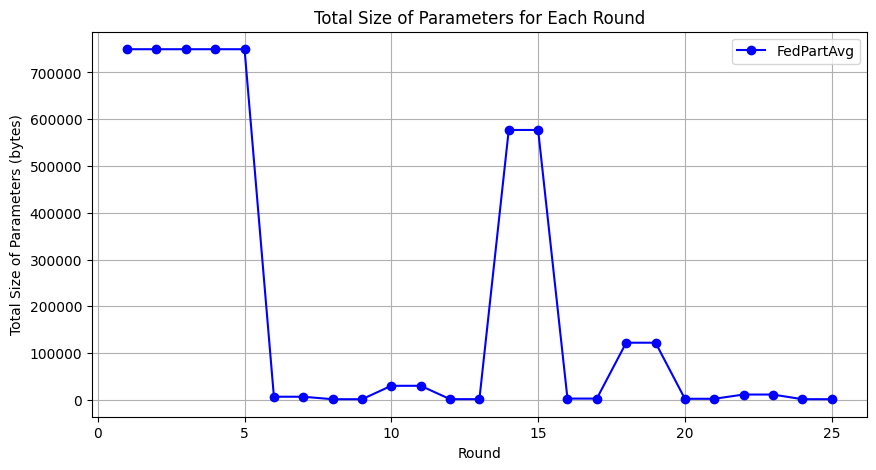

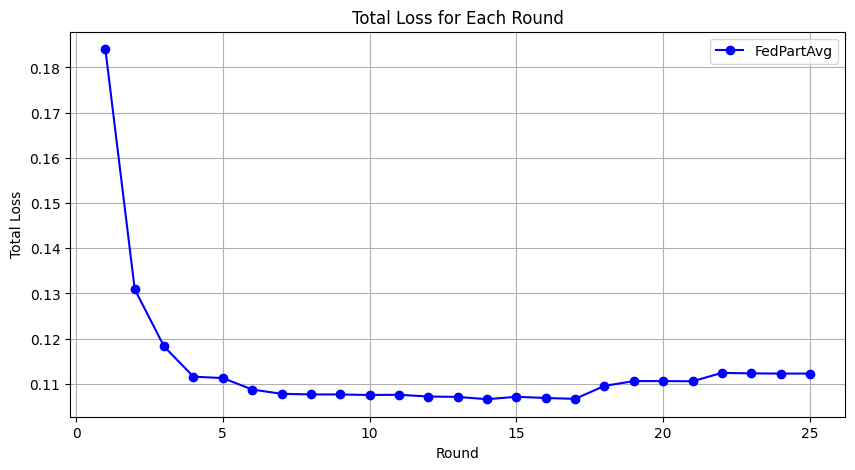

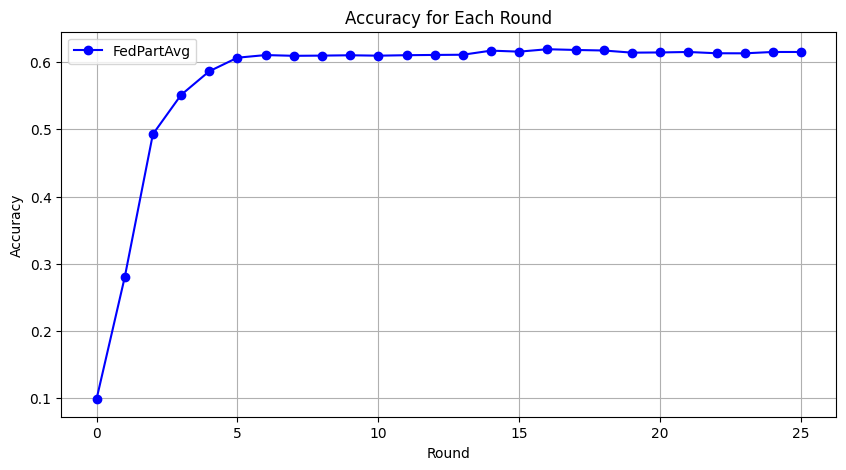

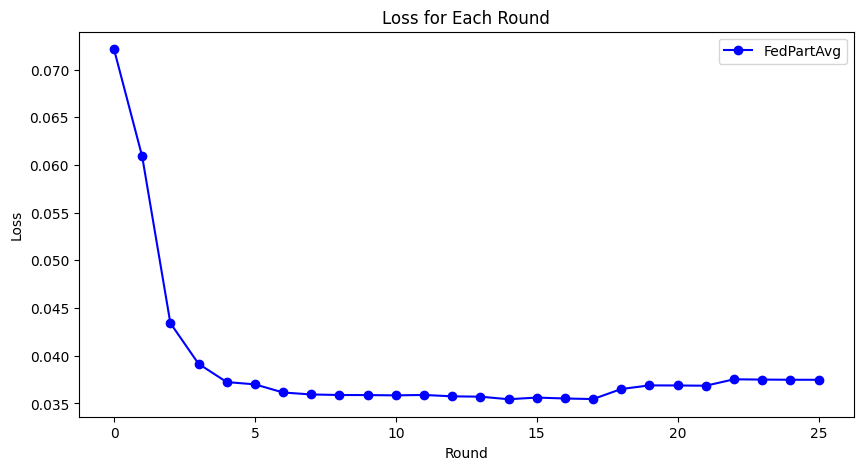

In [30]:
import matplotlib.pyplot as plt
import numpy as np



# Plot the total size of parameters for each round
fed_part_avg_rounds = list(fed_part_avg_result.keys())
fed_part_avg_sizes = [fed_part_avg_result[round]["total_size"] for round in fed_part_avg_rounds]

plt.figure(figsize=(10, 5))
plt.plot(fed_part_avg_rounds, fed_part_avg_sizes, marker='o', linestyle='-', color='b', label='FedPartAvg')
# plt.plot(fed_avg_rounds, fed_avg_sizes, marker='o', linestyle='-', color='r', label='FedAvg')
plt.xlabel('Round')
plt.ylabel('Total Size of Parameters (bytes)')
plt.title('Total Size of Parameters for Each Round')
plt.legend()
plt.grid(True)

fed_part_avg_losses = [fed_part_avg_result[round]["total_loss"] for round in fed_part_avg_rounds]

plt.figure(figsize=(10, 5))
plt.plot(fed_part_avg_rounds, fed_part_avg_losses, marker='o', linestyle='-', color='b', label='FedPartAvg')
# plt.plot(fed_avg_rounds, fed_avg_losses, marker='o', linestyle='-', color='r', label='FedAvg')
plt.xlabel('Round')
plt.ylabel('Total Loss')
plt.title('Total Loss for Each Round')
plt.legend()
plt.grid(True)


fed_part_avg_model_rounds = list(fed_part_avg_model_results.keys())
fed_part_avg_accuracies = [fed_part_avg_model_results[round]["global_metrics"]["accuracy"] for round in fed_part_avg_model_rounds]

plt.figure(figsize=(10, 5))
plt.plot(fed_part_avg_model_rounds, fed_part_avg_accuracies, marker='o', linestyle='-', color='b', label='FedPartAvg')
# plt.plot(fed_avg_model_rounds, fed_avg_accuracies, marker='o', linestyle='-', color='r', label='FedAvg')
plt.xlabel('Round')
plt.ylabel('Accuracy')
plt.title('Accuracy for Each Round')
plt.legend()
plt.grid(True)

fed_part_avg_global_losses = [fed_part_avg_model_results[round]["global_loss"] for round in fed_part_avg_model_rounds]

plt.figure(figsize=(10, 5))
plt.plot(fed_part_avg_model_rounds, fed_part_avg_global_losses, marker='o', linestyle='-', color='b', label='FedPartAvg')
# plt.plot(fed_avg_model_rounds, fed_avg_global_losses, marker='o', linestyle='-', color='r', label='FedAvg')
plt.xlabel('Round')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss for Each Round')
